<a href="https://colab.research.google.com/github/nemoland4/Tomato_Diseases_Detection/blob/main/Custom_Scaled_YOLOv4.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!nvidia-smi

Mon Feb  8 14:39:40 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.39       Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   55C    P8    11W /  70W |      0MiB / 15079MiB |      0%      Default |
|                               |                      |                 ERR! |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

#Install Model

In [2]:
# clone Scaled_YOLOv4
!git clone https://github.com/WongKinYiu/ScaledYOLOv4.git  # clone repo
%cd /content/ScaledYOLOv4/
#checkout the yolov4-large branch
!git checkout yolov4-large

Cloning into 'ScaledYOLOv4'...
remote: Enumerating objects: 10, done.
remote: Counting objects: 100% (10/10), done.
remote: Compressing objects: 100% (10/10), done.
remote: Total 131 (delta 3), reused 3 (delta 0), pack-reused 121
Receiving objects: 100% (131/131), 348.53 KiB | 17.43 MiB/s, done.
Resolving deltas: 100% (53/53), done.
/content/ScaledYOLOv4
Branch 'yolov4-large' set up to track remote branch 'yolov4-large' from 'origin'.
Switched to a new branch 'yolov4-large'


In [3]:
#install mish activation funciton for cuda
%cd /content/
!git clone https://github.com/JunnYu/mish-cuda
%cd mish-cuda
!python setup.py build install

/content
Cloning into 'mish-cuda'...
remote: Enumerating objects: 85, done.
remote: Counting objects: 100% (85/85), done.
remote: Compressing objects: 100% (71/71), done.
remote: Total 192 (delta 5), reused 80 (delta 4), pack-reused 107
Receiving objects: 100% (192/192), 208.06 KiB | 18.91 MiB/s, done.
Resolving deltas: 100% (54/54), done.
/content/mish-cuda
/usr/lib/python3.6/distutils/extension.py:131: UserWarning: Unknown Extension options: 'headers'
  warnings.warn(msg)
running build
running build_py
creating build
creating build/lib.linux-x86_64-3.6
creating build/lib.linux-x86_64-3.6/mish_cuda
copying src/mish_cuda/__init__.py -> build/lib.linux-x86_64-3.6/mish_cuda
running egg_info
creating src/mish_cuda.egg-info
writing src/mish_cuda.egg-info/PKG-INFO
writing dependency_links to src/mish_cuda.egg-info/dependency_links.txt
writing requirements to src/mish_cuda.egg-info/requires.txt
writing top-level names to src/mish_cuda.egg-info/top_level.txt
writing manifest file 'src/mish_cu

In [4]:
!pip install -U PyYAML

     |████████████████████████████████| 645kB 18.2MB/s 
  Found existing installation: PyYAML 3.13
    Uninstalling PyYAML-3.13:
      Successfully uninstalled PyYAML-3.13


In [5]:
%cd /content/ScaledYOLOv4/


/content/ScaledYOLOv4


# Download Correctly Formatted Custom Dataset (from api) and train

In [6]:
# Export code snippet and paste here
%cd /content
!curl -L "https://app.roboflow.com/ds/uY2kTXg7Sk?key=xPHKS7IQIc" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip


/content
  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100   896  100   896    0     0   1131      0 --:--:-- --:--:-- --:--:--  1129
100 59.6M  100 59.6M    0     0  37.4M      0  0:00:01  0:00:01 --:--:--  124M
Archive:  roboflow.zip
 extracting: README.roboflow.txt     
 extracting: data.yaml               
   creating: test/
   creating: test/images/
 extracting: test/images/Tomato___Septoria_leaf_spot--100-_JPG.rf.3da97d05ecae626f6f1f9f8d284efd4c.jpg  
 extracting: test/images/Tomato___Septoria_leaf_spot--1004-_JPG.rf.4c1b351325da6d40c2825839e77a9699.jpg  
 extracting: test/images/Tomato___Septoria_leaf_spot--1006-_JPG.rf.6f0ccc40195555098bd70d27009bc82d.jpg  
 extracting: test/images/Tomato___Septoria_leaf_spot--1021-_JPG.rf.3f8d26b5716d7c36618b84b566729771.jpg  
 extracting: test/images/Tomato___Septoria_leaf_spot--1034-_JPG.rf.c25ca4f28b960cb929e2ec32450661e2.jpg  
 e

In [7]:

%cat data.yaml

train: ../train/images
val: ../valid/images

nc: 1
names: ['Tomato___Septoria_leaf_spot']

In [8]:
# train scaled-YOLOv4 on custom data for 100 epochs
# time its performance
%%time
%cd /content/ScaledYOLOv4/
!python train.py --img 416 --batch 16 --epochs 20 --data '../data.yaml' --cfg ./models/yolov4-csp.yaml --weights '' --name yolov4-csp-results  --cache

/content/ScaledYOLOv4
Using CUDA device0 _CudaDeviceProperties(name='Tesla T4', total_memory=15079MB)

Namespace(adam=False, batch_size=16, bucket='', cache_images=True, cfg='./models/yolov4-csp.yaml', data='../data.yaml', device='', epochs=20, evolve=False, global_rank=-1, hyp='data/hyp.scratch.yaml', img_size=[416, 416], local_rank=-1, logdir='runs/', multi_scale=False, name='yolov4-csp-results', noautoanchor=False, nosave=False, notest=False, rect=False, resume=False, single_cls=False, sync_bn=False, total_batch_size=16, weights='', world_size=1)
Start Tensorboard with "tensorboard --logdir runs/", view at http://localhost:6006/
2021-02-08 14:40:59.013372: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.10.1
Hyperparameters {'lr0': 0.01, 'momentum': 0.937, 'weight_decay': 0.0005, 'giou': 0.05, 'cls': 0.5, 'cls_pw': 1.0, 'obj': 1.0, 'obj_pw': 1.0, 'iou_t': 0.2, 'anchor_t': 4.0, 'fl_gamma': 0.0, 'hsv_h': 0.015, 'hsv_s': 

# tensorboard for data eval




Training losses and performance metrics are saved to Tensorboard and also to a logfile defined above with the **--name** flag when we train. In our case, we named this `yolov5s_results`. (If given no name, it defaults to `results.txt`.) The results file is plotted as a png after training completes.

Note from Glenn: Partially completed `results.txt` files can be plotted with `from utils.utils import plot_results; plot_results()`.

In [9]:
# Start tensorboard
# Launch after you have started training
# logs save in the folder "runs"
%load_ext tensorboard
%tensorboard --logdir runs

<IPython.core.display.Javascript object>

In [10]:
# we can also output some older school graphs if the tensor board isn't working for whatever reason... 
#from utils.general import plot_results  # plot results.txt as results.png
from IPython.display import Image, display
display(Image('/content/ScaledYOLOv4/runs/exp1_yolov4-csp-results/results.png'))  # view results.png

### Curious? Visualize Our Training Data with Labels

After training starts, view `train*.jpg` images to see training images, labels and augmentation effects.

Note a mosaic dataloader is used for training (shown below), a new dataloading concept developed by Glenn Jocher and first featured in [YOLOv4](https://arxiv.org/abs/2004.10934).

GROUND TRUTH TRAINING DATA:


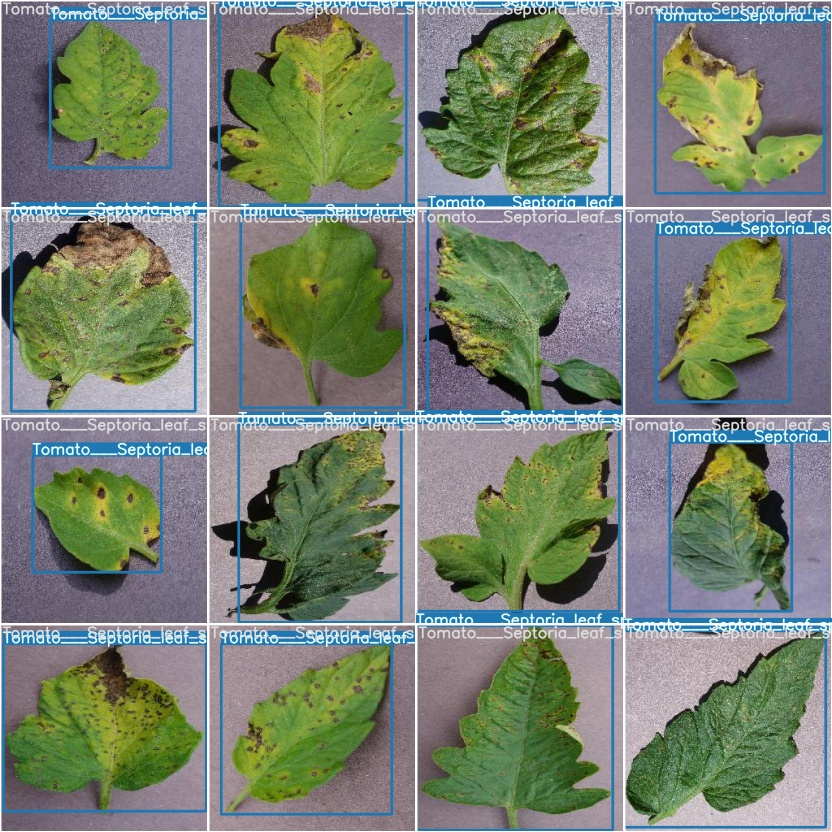

In [11]:
# first, display our ground truth data
print("GROUND TRUTH TRAINING DATA:")
Image(filename='/content/ScaledYOLOv4/runs/exp0_yolov4-csp-results/test_batch0_gt.jpg', width=900)

GROUND TRUTH AUGMENTED TRAINING DATA:


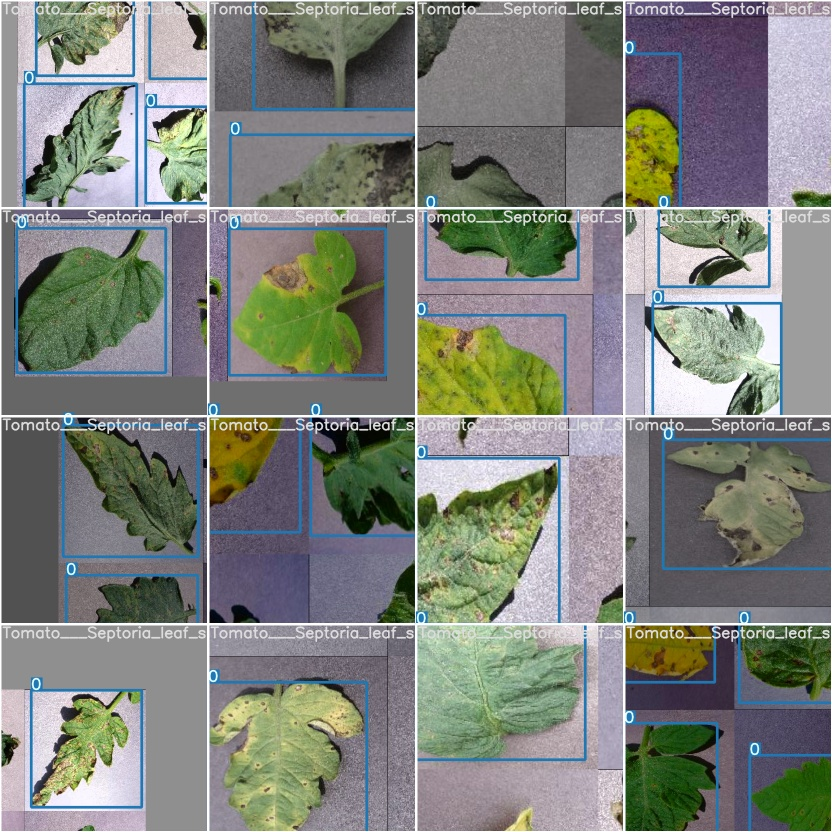

In [12]:
# print out an augmented training example
print("GROUND TRUTH AUGMENTED TRAINING DATA:")
Image(filename='/content/ScaledYOLOv4/runs/exp0_yolov4-csp-results/train_batch0.jpg', width=900)

#Run Inference  With Trained Weights

In [13]:

%ls runs/

exp0_yolov4-csp-results/


In [14]:
%ls ./runs/exp0_yolov4-csp-results/weights

best_yolov4-csp-results.pt        last_006.pt  last_014.pt
best_yolov4-csp-results_strip.pt  last_007.pt  last_015.pt
last_000.pt                       last_008.pt  last_016.pt
last_001.pt                       last_009.pt  last_017.pt
last_002.pt                       last_010.pt  last_018.pt
last_003.pt                       last_011.pt  last_019.pt
last_004.pt                       last_012.pt  last_yolov4-csp-results.pt
last_005.pt                       last_013.pt  last_yolov4-csp-results_strip.pt


In [15]:

%cd /content/ScaledYOLOv4/
!python detect.py --weights /content/ScaledYOLOv4/runs/exp0_yolov4-csp-results/weights/best_yolov4-csp-results.pt  --img 416 --conf 0.4 --source /content/test/images

/content/ScaledYOLOv4
Namespace(agnostic_nms=False, augment=False, classes=None, conf_thres=0.4, device='', img_size=416, iou_thres=0.5, output='inference/output', save_txt=False, source='/content/test/images', update=False, view_img=False, weights=['/content/ScaledYOLOv4/runs/exp0_yolov4-csp-results/weights/best_yolov4-csp-results.pt'])
Using CUDA device0 _CudaDeviceProperties(name='Tesla T4', total_memory=15079MB)

Fusing layers... Model Summary: 235 layers, 5.24706e+07 parameters, 5.04494e+07 gradients
image 1/177 /content/test/images/Tomato___Septoria_leaf_spot--100-_JPG.rf.3da97d05ecae626f6f1f9f8d284efd4c.jpg: 416x416 1 Tomato___Septoria_leaf_spots, Done. (0.026s)
image 2/177 /content/test/images/Tomato___Septoria_leaf_spot--1004-_JPG.rf.4c1b351325da6d40c2825839e77a9699.jpg: 416x416 1 Tomato___Septoria_leaf_spots, Done. (0.026s)
image 3/177 /content/test/images/Tomato___Septoria_leaf_spot--1006-_JPG.rf.6f0ccc40195555098bd70d27009bc82d.jpg: 416x416 1 Tomato___Septoria_leaf_spots, D

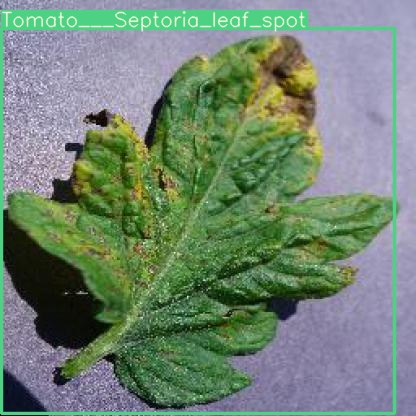

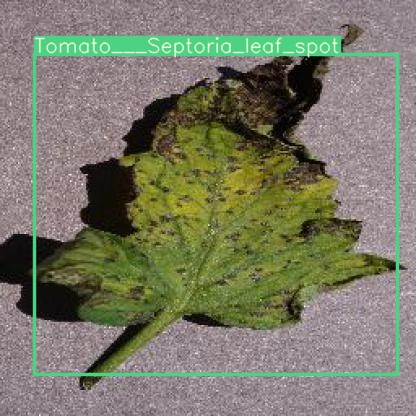

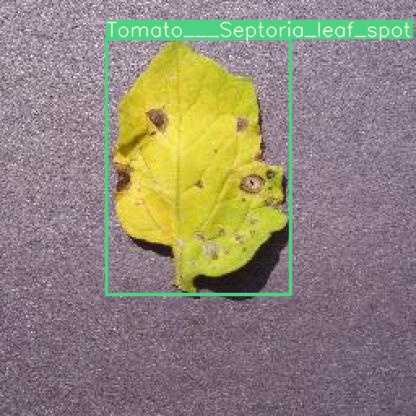

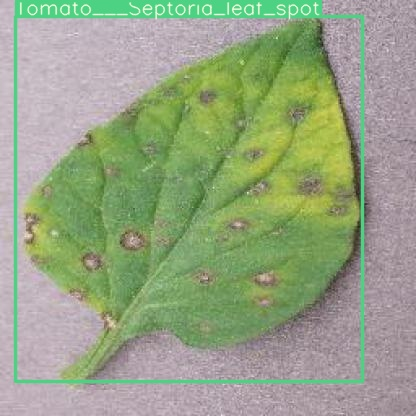

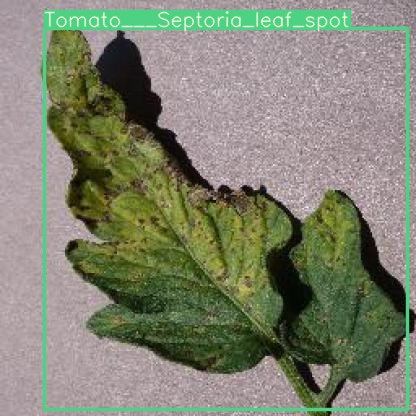

...

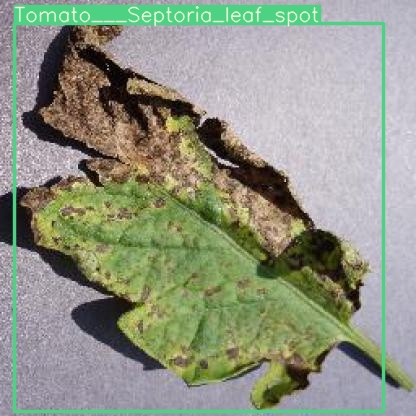

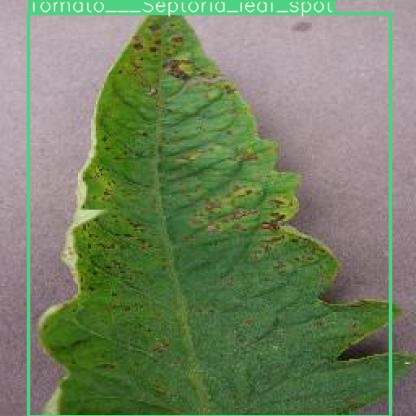

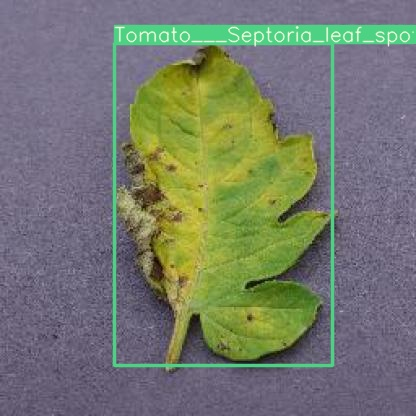

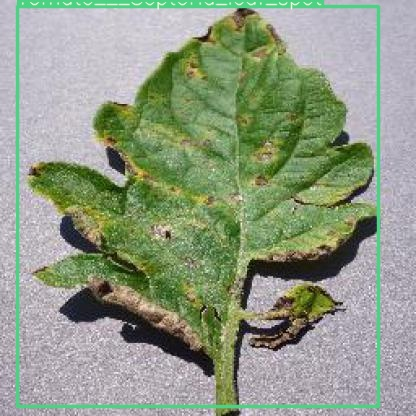

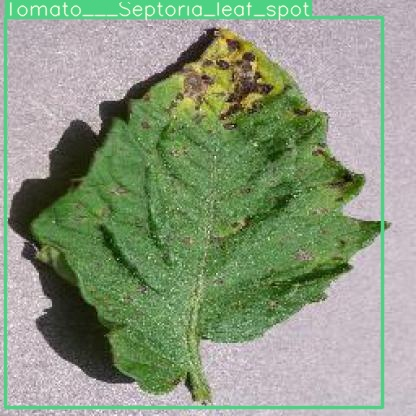

In [16]:
#display inference on ALL test images

import glob
from IPython.display import Image, display

for imageName in glob.glob('./inference/output/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")

In [17]:
%ls

data/      inference/  __pycache__/  runs/    train.py
detect.py  models/     README.md     test.py  utils/


# Download weights

In [ ]:
from google.colab import files
files.download('./runs/exp0_yolov4-csp-results/weights/best_yolov4-csp-results.pt')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>